This notebook reproduces the experimental results presented in our manuscript. Instructions for accessing the data are available in /data/README.md.

In [1]:
import os
import torch
import pandas as pd
import scanpy as sc
import SpatialGlue

device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')

os.environ['R_HOME'] = '/home/ws6tg/anaconda3/envs/EnvR43/lib/R/'

In [3]:
adata_all=sc.read_h5ad("adata_SMART.h5ad")
adata2=sc.read_h5ad("adata_MultiVI.h5ad")
adata3=sc.read_h5ad("adata_PresentBC.h5ad")
adata4=sc.read_h5ad("adata_totalVI.h5ad")
adata5=sc.read_h5ad("adata_MOFA.h5ad")

In [5]:
adata_all.obsm["SMART-MS"]=adata_all.obsm["SMART"]
adata_all.obsm["MultiVI"]=adata2.obsm["MultiVI"]
adata_all.obsm["Present-BC"]=adata3.obsm["embeddings"]
adata_all.obsm["TotalVI"]=adata4.obsm["X_totalVI"]
adata_all.obsm["MOFA+"]=adata5.obsm["MOFA+"]

In [7]:
import sys
sys.path.append('../../model/') 
from utils import clustering
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score, adjusted_mutual_info_score, \
    homogeneity_score, mutual_info_score, v_measure_score,fowlkes_mallows_score

tool = 'mclust'  # mclust, leiden, and louvain
for i in range(4,9):
    for j in ['ADT+harmony','RNA+harmony',"SMART-MS","MultiVI","Present-BC","TotalVI","MOFA+"]:
        clustering(adata_all, key=j, add_key=f'{j}_{i}', n_clusters=i, method=tool if j!="MOFA+" else "kmeans", use_pca=True if adata_all.obsm[j].shape[1]>20 else False)

R[write to console]:                    __           __ 
   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.0.0
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |=================================================================

In [8]:
df_sup = pd.DataFrame(columns=["n_cluster","method","batch","metries","score"])

tool = 'mclust'  # mclust, leiden, and louvain
for i in range(4,9):
    for j in ['ADT+harmony','RNA+harmony',"SMART-MS","MultiVI","Present-BC","TotalVI","MOFA+"]:
        for b in ["s1","s2","s3","all"]:
            #tool if j!="MOFA+" else "gmm"
            adata=adata_all[~adata_all.obs['anno'].isna()]
            if b!="all":
                adata_=adata[adata.obs["src"]==b]
            else:
                adata_=adata
            n=f'{j}_{i}'
            ari = adjusted_rand_score(adata_.obs['anno'], adata_.obs[n])
            nmi = normalized_mutual_info_score(adata_.obs['anno'], adata_.obs[n])
            ami = adjusted_mutual_info_score(adata_.obs['anno'], adata_.obs[n])
            homogeneity = homogeneity_score(adata_.obs['anno'], adata_.obs[n])
            mutual_info = mutual_info_score(adata_.obs['anno'], adata_.obs[n])
            v_measure = v_measure_score(adata_.obs['anno'], adata_.obs[n])
            fmi=fowlkes_mallows_score(adata_.obs['anno'], adata_.obs[n])
            
            d={"ARI": ari,
                    "NMI": nmi,
                    "AMI": ami,
                    "Homo": homogeneity,
                    "MI": mutual_info,
                    "V-Measure": v_measure,
                    "FMI": fmi}
            for k,v in d.items():
                 df_sup.loc[len(df_sup.index)]=[i,j,b,k,v]

In [10]:
import scib
import scib_metrics

def metrics(adata, use_rep, batch_key, label_key,threshold=None):
    sc.pp.neighbors(adata, use_rep=use_rep,n_neighbors=30)
    
    GC = scib.me.graph_connectivity(adata, label_key=label_key)
    iLISI = scib.me.ilisi_graph(adata, batch_key=batch_key, type_="embed", use_rep=use_rep)
    kBET = scib.me.kBET(adata, batch_key=batch_key, label_key=label_key, type_="embed", embed=use_rep)
    bASW = scib.me.silhouette_batch(adata, batch_key=batch_key, label_key=label_key, embed=use_rep)

    #isolated_asw = scib.me.isolated_labels_asw(adata, batch_key=batch_key, label_key=label_key, embed=use_rep, iso_threshold=threshold)
    
    isolated_label = scib_metrics.isolated_labels(adata.obsm[use_rep], adata.obs[label_key], adata.obs[batch_key])
    cASW = scib.me.silhouette(adata, label_key=label_key, embed=use_rep)
    cLISI = scib.me.clisi_graph(adata, label_key=label_key, type_="embed", use_rep=use_rep)
    
    print('GC: %.3f, iLISI: %.3f, kBET: %.3f, bASW: %.3f' % (GC, iLISI, kBET, bASW))
    # print('isolated_asw: %.3f, isolated_f1: %.3f' % (isolated_asw, isolated_f1))
    print('isolated_label: %.3f, cASW: %.3f, cLISI: %.3f' % ( isolated_label,cASW, cLISI))
    
    return {'GC':GC,'iLISI':iLISI,'kBET':kBET,'bASW':bASW,'Isolated Label Score':isolated_label,"cASW":cASW,"cLISI":cLISI}

/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/umap/__init__.py:9: ImportWarning: Tensorflow not installed; ParametricUMAP will be unavailable
  warn(


In [11]:
import scib_metrics
import scib

adata_1=adata_all[~adata_all.obs['anno'].isna()]
df_ = pd.DataFrame(columns=["method","metries","score"])
for j in ['ADT+harmony','RNA+harmony',"SMART-MS","MultiVI","Present-BC","TotalVI","MOFA+"]:
    label_key="anno"
    batch_key="batch"
    d=metrics(adata_1, j, batch_key, label_key)
    for k,v in d.items():
        df_.loc[len(df_.index)]=[j,k,v]

/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).

0 labels consist of a single batch or is too small. Skip.


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib_metrics/_isolated_labels.py:69: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_per_lab = tmp.groupby(label_key).agg({batch_key: "count"})


mean silhouette per group:                                 silhouette_score
group                                           
connective & epithelial tissue          0.936034
germinal center                         0.974259
lymphoid follicle                       0.959708
tonsillar parenchyma                    0.982046
GC: 0.987, iLISI: 0.782, kBET: 0.532, bASW: 0.963
isolated_label: 0.516, cASW: 0.505, cLISI: 0.808


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).

0 labels consist of a single batch or is too small. Skip.


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


mean silhouette per group:                                 silhouette_score
group                                           
connective & epithelial tissue          0.945626
germinal center                         0.944912
lymphoid follicle                       0.954006
tonsillar parenchyma                    0.976033


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib_metrics/_isolated_labels.py:69: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_per_lab = tmp.groupby(label_key).agg({batch_key: "count"})


GC: 0.988, iLISI: 0.740, kBET: 0.425, bASW: 0.955
isolated_label: 0.545, cASW: 0.507, cLISI: 0.830


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).

0 labels consist of a single batch or is too small. Skip.
Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6
Adding diffusion to step 7
Adding diffusion to step 8


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6
Adding diffusion to step 7


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6
Adding diffusion to step 7


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


mean silhouette per group:                                 silhouette_score
group                                           
connective & epithelial tissue          0.915780
germinal center                         0.892921
lymphoid follicle                       0.932817
tonsillar parenchyma                    0.954096


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib_metrics/_isolated_labels.py:69: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_per_lab = tmp.groupby(label_key).agg({batch_key: "count"})


GC: 0.983, iLISI: 0.813, kBET: 0.623, bASW: 0.924
isolated_label: 0.538, cASW: 0.481, cLISI: 0.826


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).

0 labels consist of a single batch or is too small. Skip.
Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6
Adding diffusion to step 7


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6
Adding diffusion to step 7
Adding diffusion to step 8


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


mean silhouette per group:                                 silhouette_score
group                                           
connective & epithelial tissue          0.926793
germinal center                         0.939353
lymphoid follicle                       0.930084
tonsillar parenchyma                    0.969535


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib_metrics/_isolated_labels.py:69: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_per_lab = tmp.groupby(label_key).agg({batch_key: "count"})


GC: 0.985, iLISI: 0.778, kBET: 0.571, bASW: 0.941
isolated_label: 0.566, cASW: 0.532, cLISI: 0.838


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).

0 labels consist of a single batch or is too small. Skip.
Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


mean silhouette per group:                                 silhouette_score
group                                           
connective & epithelial tissue          0.974075
germinal center                         0.950909
lymphoid follicle                       0.964342
tonsillar parenchyma                    0.989660


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib_metrics/_isolated_labels.py:69: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_per_lab = tmp.groupby(label_key).agg({batch_key: "count"})


GC: 0.988, iLISI: 0.737, kBET: 0.394, bASW: 0.970
isolated_label: 0.561, cASW: 0.515, cLISI: 0.841


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).

0 labels consist of a single batch or is too small. Skip.
Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


Adding diffusion to step 4


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


mean silhouette per group:                                 silhouette_score
group                                           
connective & epithelial tissue          0.942708
germinal center                         0.927461
lymphoid follicle                       0.923416
tonsillar parenchyma                    0.947335


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib_metrics/_isolated_labels.py:69: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_per_lab = tmp.groupby(label_key).agg({batch_key: "count"})


GC: 0.990, iLISI: 0.386, kBET: 0.002, bASW: 0.935
isolated_label: 0.542, cASW: 0.515, cLISI: 0.818


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  tab = pd.value_counts(labels)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/graph_connectivity.py:56: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).

0 labels consist of a single batch or is too small. Skip.


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5
Adding diffusion to step 6


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


Adding diffusion to step 4


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:158: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  comp_size = pd.value_counts(labs)


Adding diffusion to step 4
Adding diffusion to step 5


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib/metrics/kbet.py:229: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


mean silhouette per group:                                 silhouette_score
group                                           
connective & epithelial tissue          0.953059
germinal center                         0.948851
lymphoid follicle                       0.952492
tonsillar parenchyma                    0.986019


/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/scib_metrics/_isolated_labels.py:69: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  batch_per_lab = tmp.groupby(label_key).agg({batch_key: "count"})


GC: 0.989, iLISI: 0.540, kBET: 0.225, bASW: 0.960
isolated_label: 0.536, cASW: 0.516, cLISI: 0.847


In [66]:
df_sup.to_csv("df_sup.csv")
df_.to_csv("df_.csv")
adata_all.write_h5ad("adata_all.h5ad")

In [2]:
df_sup=pd.read_csv("df_sup.csv")
df_=pd.read_csv("df_.csv")
adata_all=sc.read_h5ad("adata_all.h5ad")

In [64]:
r1=df_sup[df_sup["batch"]=="all"][["n_cluster","method","metries","score"]].groupby(["method","metries"]).mean().reset_index().pivot(index="method",columns="metries",values='score')
r2=df_.groupby(["method","metries"]).mean().reset_index().pivot(index="method",columns="metries",values='score')
df=pd.merge(r1,r2,left_index=True,right_index=True)
df

metries,AMI,ARI,FMI,Homo,MI,NMI,V-Measure,GC,Isolated Label Score,bASW,cASW,cLISI,iLISI,kBET
method,,,,,,,,,,,,,,
ADT+harmony,0.262600,0.164610,0.431412,0.325660,0.350444,0.262907,0.262907,0.987282,0.516219,0.963012,0.505455,0.807830,0.781895,0.532389
MOFA+,0.244839,0.153575,0.413911,0.308723,0.332218,0.245149,0.245149,0.988839,0.536131,0.960105,0.515512,0.846589,0.540435,0.224884
MultiVI,0.239902,0.121233,0.408147,0.295213,0.317680,0.240222,0.240222,0.984689,0.565975,0.941441,0.531748,0.837621,0.778433,0.571084
Present-BC,0.243119,0.152919,0.427904,0.300066,0.322902,0.243436,0.243436,0.987772,0.560643,0.969747,0.515116,0.840933,0.736516,0.394294
RNA+harmony,0.266705,0.179536,0.442471,0.333704,0.359100,0.267007,0.267007,0.987692,0.544736,0.955144,0.506757,0.829549,0.740119,0.424776
SMART-MS,0.258018,0.173767,0.426890,0.329710,0.354802,0.258318,0.258318,0.983082,0.537590,0.923903,0.480511,0.825692,0.812606,0.622819
TotalVI,0.169917,0.078566,0.365331,0.218827,0.235481,0.170256,0.170256,0.989927,0.541794,0.935230,0.515308,0.818372,0.386344,0.002174


In [65]:
df['Isolated Label']=df['Isolated Label Score']

In [66]:
metries1=['ARI','FMI','NMI','AMI','MI',"V-Measure","Homo"]
metries2=['iLISI','kBET']
df1=df[metries1+metries2]

In [67]:
df1["Bio conservation"]=df1[metries1].mean(axis=1)
df1["Batch correction"]=df1[metries2].mean(axis=1)
df1["Total"]=df1[metries1+metries2].mean(axis=1)

df1.loc["Metric Type"]=["Bio conservation"]*len(metries1)+["Batch correction"]*len(metries2)+["Aggregate score"]*3

/tmp/ipykernel_126232/2049154310.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1["Bio conservation"]=df1[metries1].mean(axis=1)
/tmp/ipykernel_126232/2049154310.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1["Batch correction"]=df1[metries2].mean(axis=1)
/tmp/ipykernel_126232/2049154310.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas

In [68]:
df1

metries,ARI,FMI,NMI,AMI,MI,V-Measure,Homo,iLISI,kBET,Bio conservation,Batch correction,Total
method,,,,,,,,,,,,
ADT+harmony,0.16461,0.431412,0.262907,0.2626,0.350444,0.262907,0.32566,0.781895,0.532389,0.294363,0.657142,0.37498
MOFA+,0.153575,0.413911,0.245149,0.244839,0.332218,0.245149,0.308723,0.540435,0.224884,0.277652,0.382659,0.300987
MultiVI,0.121233,0.408147,0.240222,0.239902,0.31768,0.240222,0.295213,0.778433,0.571084,0.266088,0.674758,0.356904
Present-BC,0.152919,0.427904,0.243436,0.243119,0.322902,0.243436,0.300066,0.736516,0.394294,0.276254,0.565405,0.34051
RNA+harmony,0.179536,0.442471,0.267007,0.266705,0.3591,0.267007,0.333704,0.740119,0.424776,0.302219,0.582448,0.364492
SMART-MS,0.173767,0.42689,0.258318,0.258018,0.354802,0.258318,0.32971,0.812606,0.622819,0.29426,0.717712,0.388361
TotalVI,0.078566,0.365331,0.170256,0.169917,0.235481,0.170256,0.218827,0.386344,0.002174,0.201233,0.194259,0.199683
Metric Type,Bio conservation,Bio conservation,Bio conservation,Bio conservation,Bio conservation,Bio conservation,Bio conservation,Batch correction,Batch correction,Aggregate score,Aggregate score,Aggregate score


In [ ]:
from muon import prot as pt
import sys 
sys.path.append("..") 
sys.path.append("../../model/")
from utils import pca
 
# read data
file_folds = ['../../datasets/Human_tonsil/slice1/','../../datasets/Human_tonsil/slice2/','../../datasets/Human_tonsil/slice3/']  #please replace 'file_fold' with the download path
name = ["Replicate-1", "Replicate-2", "Replicate-3"]
rna_adatas = {}
adt_adatas = {}
for file_fold, name in zip(file_folds, name):
    adata_omics1 = sc.read_h5ad(file_fold + 'adata_rna.h5ad')
    adata_omics2 = sc.read_h5ad(file_fold + 'adata_adt.h5ad')

    adata_omics1.var_names_make_unique()
    adata_omics2.var_names_make_unique()
    
    rna_adatas[name] = adata_omics1.copy()
    adt_adatas[name] = adata_omics2.copy()

adata_RNA=sc.concat(rna_adatas, label="batch",index_unique="_")
adata_ADT=sc.concat(adt_adatas, label="batch",index_unique="_")

# RNA
sc.pp.filter_genes(adata_RNA, min_cells=10)
sc.pp.highly_variable_genes(adata_RNA, flavor="seurat_v3", n_top_genes=5000)
sc.pp.normalize_total(adata_RNA, target_sum=1e4)
sc.pp.log1p(adata_RNA)

# Protein
pt.pp.clr(adata_ADT)

adata_RNA.obs['SMART-MS_6']=adata_all.obs['SMART-MS_6']
sc.tl.rank_genes_groups(adata_RNA, 'SMART-MS_6', method='wilcoxon')  # calculate differentially expressed genes
adata_ADT.obs['SMART-MS_6']=adata_all.obs['SMART-MS_6']
sc.tl.rank_genes_groups(adata_ADT, 'SMART-MS_6', method='wilcoxon') 

/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/muon/_prot/preproc.py:219: UserWarning: adata.X is sparse but not in CSC format. Converting to CSC.
  warn("adata.X is sparse but not in CSC format. Converting to CSC.")


In [18]:
SMART_markers = {
    "Follicle": ["CD19","CD22", "MS4A1","IGHM"],
    "Germinal center": ["CR2","BCL2A1", "LMO2"],
    "T cell zone": ["CD3E", "CD4", "CD8A", "CCL19"],
    "Epithelial-1": ["LTF", "EPCAM", "CCL20"],
    "Epithelial-2": ["KRT4", "KRT13", "S100A2"],
    "Plasma cell zone":["IGHG1", "CXCL12", "MZB1", "ITM2C"]
}


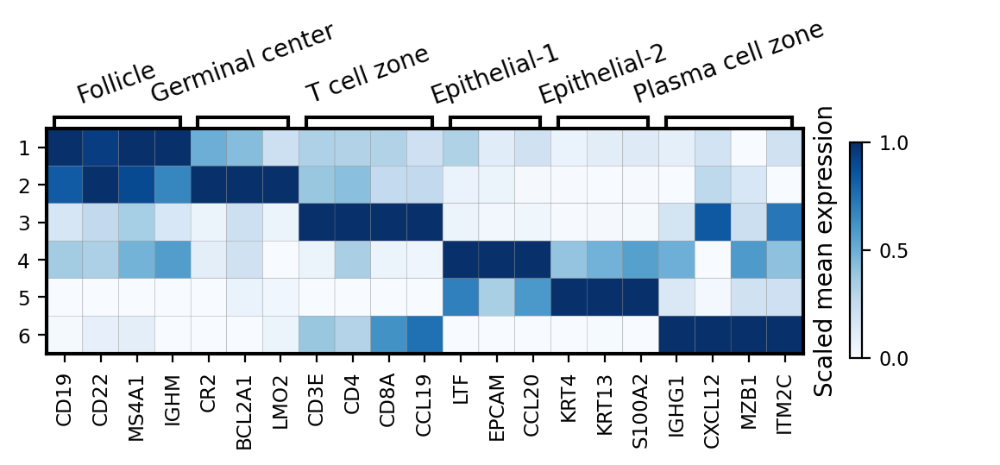

In [ ]:
from matplotlib import pyplot as plt

# Create a figure and axes
fig, ax = plt.subplots(1,1,figsize=(7, 2.5),dpi=200)
mp=sc.pl.matrixplot(adata_RNA, SMART_markers , groupby='SMART-MS_6', 
                 var_group_rotation=20,
                 swap_axes=False,cmap="Blues",standard_scale="var",ax=ax,show=False)
mp['color_legend_ax'].remove()

cmap = mpl.colormaps['Blues']
norm = mpl.colors.Normalize(vmin=0, vmax=1)
cbar_ax = fig.add_axes([0.79, 0.1, 0.01, 0.5])  
cbar = fig.colorbar(
    mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
    cax=cbar_ax, orientation='vertical',ticks=[0,.5,1]
)
cbar.ax.tick_params(labelsize=8)
# set label
cbar.set_label('Scaled mean expression', rotation=90, size=10,labelpad=-40)

plt.show()
fig.savefig("rna_matrixplot.svg",format="svg",bbox_inches='tight',transparent=True)

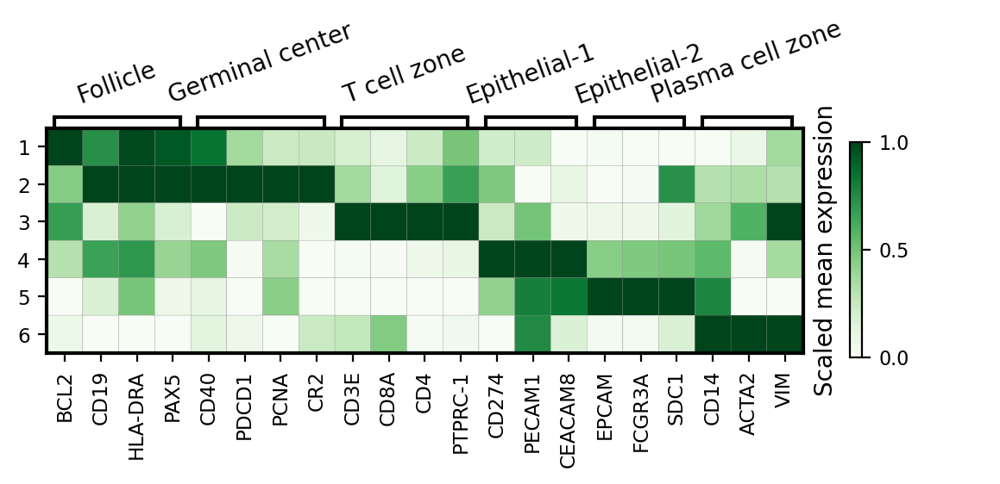

In [ ]:
SMART_markers_adt = {
    "Follicle": ["BCL2","CD19",'HLA-DRA', "PAX5"],
    "Germinal center": ['CD40',"PDCD1","PCNA", "CR2"],
    "T cell zone": ["CD3E",  "CD8A","CD4", "PTPRC-1"],
    "Epithelial-1": ["CD274", "PECAM1","CEACAM8"],
    "Epithelial-2": ["EPCAM", 'FCGR3A',"SDC1"],
    "Plasma cell zone":["CD14", "ACTA2", "VIM"]
}
fig, ax = plt.subplots(1,1,figsize=(7, 2.5),dpi=200)
mp=sc.pl.matrixplot(adata_ADT, SMART_markers_adt , groupby='SMART-MS_6', 
                 var_group_rotation=20,
                 swap_axes=False,cmap="Greens",standard_scale="var",ax=ax,show=False)
mp['color_legend_ax'].remove()


cmap = mpl.colormaps['Greens']
norm = mpl.colors.Normalize(vmin=0, vmax=1)
cbar_ax = fig.add_axes([0.79, 0.1, 0.01, 0.5])  
cbar = fig.colorbar(
    mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
    cax=cbar_ax, orientation='vertical',ticks=[0,.5,1]
)
cbar.ax.tick_params(labelsize=8)
# set label
cbar.set_label('Scaled mean expression', rotation=90, size=10,labelpad=-40)

plt.show()
fig.savefig("adt_matrixplot.svg",format="svg",bbox_inches='tight',transparent=True)

In [23]:
adata_all.obs["SMART-MS Clusters Anno"]=adata_all.obs["SMART-MS_6"].map(dict(zip(range(1,7),SMART_markers.keys())))

In [24]:
adata_all.obs["Manual Annotation"]=adata_all.obs["anno"].map(lambda x:str(x).replace(" & "," &\n"))

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances
from scipy.stats import pearsonr

dis2=pairwise_distances(adata_all.obsm["ADT+harmony"])
dis1=pairwise_distances(adata_all.obsm["RNA+harmony"])
df2=pd.DataFrame(columns=["cluster","modality","pearsonr"])
dis=pairwise_distances(adata_all.obsm["SMART-MS"])
for i,j in enumerate(adata_all.obs["SMART-MS Clusters Anno"].values):
    corr, _ = pearsonr(dis[i], dis2[i])
    df2.loc[len(df2)]=[j,"ADT",corr]
    corr, _ = pearsonr(dis[i], dis1[i])
    df2.loc[len(df2)]=[j,"RNA",corr]

/tmp/ipykernel_126232/2419177261.py:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(),rotation=25, ha='center')


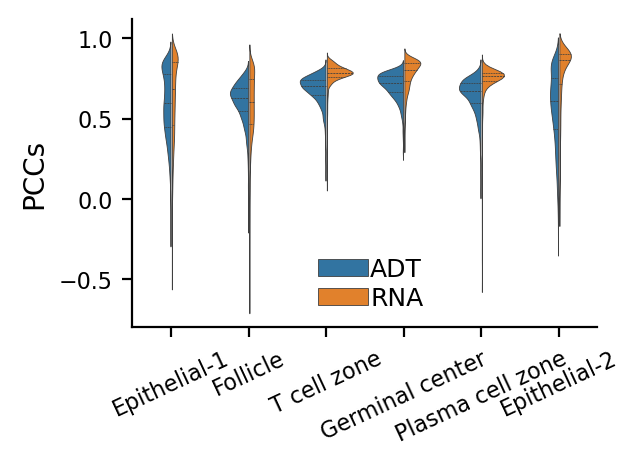

In [75]:
import seaborn as sns

fig,ax = plt.subplots(figsize=(3,2),dpi=200)
ax.tick_params(labelsize=8)
sns.violinplot(df2,x="cluster",y="pearsonr",hue="modality", split=True, gap=.05, inner="quart",linewidth=0.3,width=0.7)
ax.set_ylabel("PCCs")
ax.set_xlabel("")
ax.set_xticklabels(ax.get_xticklabels(),rotation=25, ha='center')
ax.legend(bbox_to_anchor=(0.35,0.3),frameon=False,ncol=1,labelspacing=0.2,handletextpad=0.1,fontsize=9)
sns.despine()
fig.savefig("PCCs.svg",format="svg",bbox_inches='tight',transparent=True)

In [ ]:
adata=adata_all
colors = [
    '#1f77b4',  # 蓝色
    '#ff7f0e',  # 橙色
    '#2ca02c',  # 绿色
    '#d62728',  # 红色
    '#9467bd',  # 紫色
    '#8c564b',  # 棕色
    '#e377c2',  # 粉色
    '#7f7f7f',  # 灰色
    '#bcbd22',  # 黄色
    '#17becf',  # 青色
    '#4a90e2',  # 深蓝色
    '#f5a623',  # 深橙色
    '#7ed321',  # 深绿色
    '#d0021b',  # 深红色
    '#8b6bbf',  # 深紫色
    '#a7a8aa',  # 深灰色
]

n=6
adata.obs["SMART-MS Clusters Anno"]=adata.obs["SMART-MS_6"].map(dict(zip(range(1,7),SMART_markers.keys())))
colordict1=dict(zip(adata.obs[f'SMART-MS_{n}'].unique(),colors))
colordict2=dict(zip(adata.obs["SMART-MS Clusters Anno"].unique(),colors))

In [34]:
d=pd.DataFrame(adata_all.obs[["SMART-MS Clusters Anno","batch"]].value_counts())
d=d.reset_index()
d=d.pivot_table(index="SMART-MS Clusters Anno",columns="batch",values="count")
df_normalized = d.div(d.sum(axis=0), axis=1)
df_normalized=df_normalized.sort_values(by="Replicate-1")
df_normalized

/tmp/ipykernel_126232/2258492381.py:3: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  d=d.pivot_table(index="SMART-MS Clusters Anno",columns="batch",values="count")


batch,Replicate-1,Replicate-2,Replicate-3
SMART-MS Clusters Anno,,,
Germinal center,0.085761,0.083204,0.087812
Epithelial-2,0.115349,0.105333,0.112365
Plasma cell zone,0.134535,0.138748,0.098208
Epithelial-1,0.185853,0.197389,0.240212
Follicle,0.202728,0.199159,0.194205
T cell zone,0.275774,0.276167,0.267198


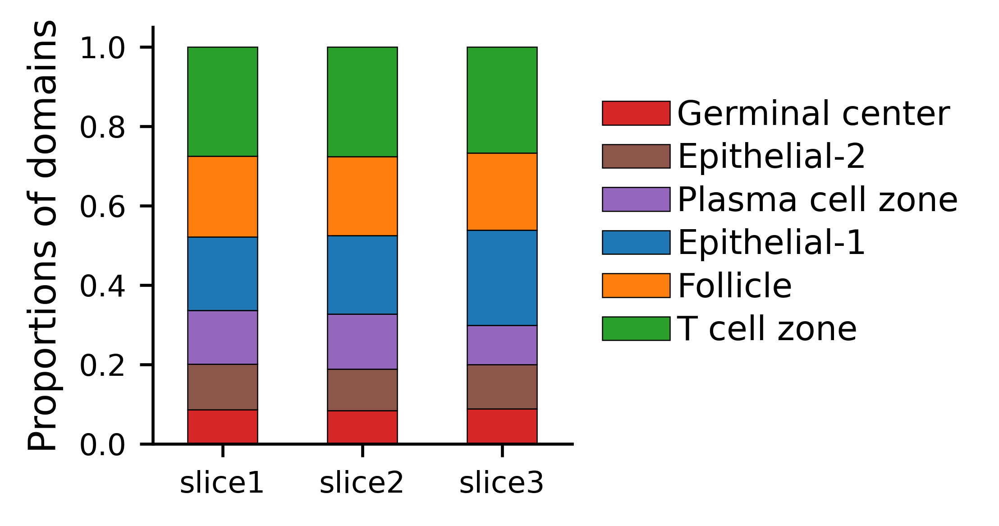

In [35]:
fig, ax = plt.subplots(figsize=(2, 2),dpi=600)
ax.tick_params(labelsize=8)
df_normalized.T.plot(kind='bar', stacked=True, ax = ax,edgecolor='black',linewidth=0.3,color=colordict2)
sns.despine()
ax.legend(bbox_to_anchor=(1,0.9),frameon=False,ncol=1,labelspacing=0.3,handletextpad=0.2,fontsize=9)
ax.set_xticklabels(["slice1","slice2","slice3"],rotation=0, ha='center')
ax.set_xlabel("")
ax.set_ylabel("Proportions of domains")
fig.savefig("Proportions.svg",format="svg",bbox_inches='tight',transparent=True)

5
2


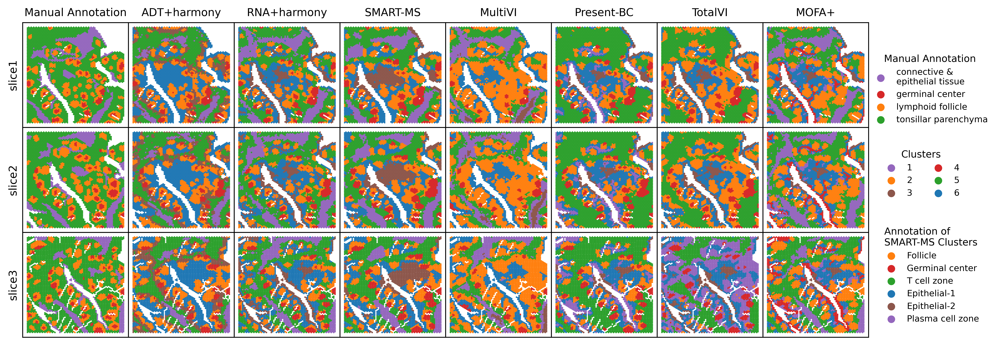

In [36]:
import matplotlib.pyplot as plt
from utils import getcolordict

plt.rcParams["axes.titlesize"] = 10
plt.rcParams["legend.fontsize"] = 8               
plt.rcParams["legend.title_fontsize"] = 9 

fig, ax_list = plt.subplots(3, 8, figsize=(14,6*7/8),dpi=600)
plt.subplots_adjust(hspace=0, wspace=0)

adata=adata_all[~adata_all.obs['anno'].isna()]
for i,k in enumerate(['Manual Annotation','ADT+harmony','RNA+harmony',"SMART-MS","MultiVI","Present-BC","TotalVI","MOFA+"]):
    if k=='Manual Annotation':
        d=k
    elif k=='SMART-MS':
        d='SMART-MS Clusters Anno'
    else:
        d=k+f"_{n}"
    
    if k=="SMART-MS":
        c=colordict2
    else:
        c=getcolordict(adata,d,"SMART-MS Clusters Anno",colordict2)
    sc.pl.embedding(adata[adata.obs["src"]=="s1"].copy(), basis='spatial', color=d, ax=ax_list[0][i], palette=c,title=k, s=9, show=False)
    sc.pl.embedding(adata[adata.obs["src"]=="s2"].copy(), basis='spatial', color=d, ax=ax_list[1][i], palette=c,title='', s=9, show=False)
    sc.pl.embedding(adata[adata.obs["src"]=="s3"].copy(), basis='spatial', color=d, ax=ax_list[2][i], palette=c,title='', s=9, show=False)
    
    ax_list[0][i].set_xlabel("")
    ax_list[1][i].set_xlabel("")
    ax_list[2][i].set_xlabel("")

    if i==0:
        ax_list[0][i].set_ylabel("slice1")
        ax_list[1][i].set_ylabel("slice2")
        ax_list[2][i].set_ylabel("slice3")
    else:
        ax_list[0][i].set_ylabel("")
        ax_list[1][i].set_ylabel("")
        ax_list[2][i].set_ylabel("")
    
    ax_list[0][i].get_legend().remove()
    ax_list[1][i].get_legend().remove()

    if k=='Manual Annotation':
        ax_list[2][i].legend(loc=(8,2),ncol=1,frameon=False,title="Manual Annotation")
    elif k=='TotalVI':
        ax_list[2][i].legend(loc=(2.1,1.3),ncol=2,frameon=False,title="Clusters")
    elif k=='SMART-MS':
        ax_list[2][i].legend(loc=(5.1,0.1),ncol=1,frameon=False,title="Annotation of\nSMART-MS Clusters")
    else:
        ax_list[2][i].get_legend().remove()
        #ax_list[2][i].legend()
    #plt.tight_layout(w_pad=0.3)
plt.show()
fig.savefig("cluster1.jpg",format="jpg",bbox_inches='tight',transparent=True)

/tmp/ipykernel_126232/739238927.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["slice"]=adata.obs["src"].map(dict(zip(["s1","s2","s3"],["slice1","slice2","slice3"])))


5
2


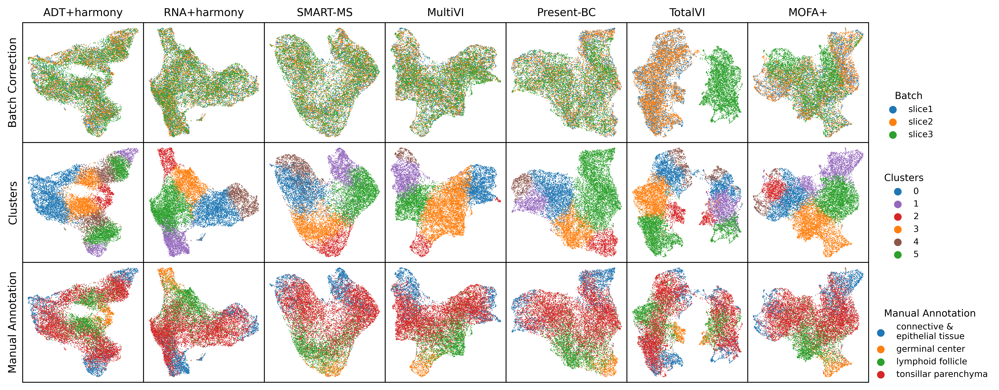

In [37]:
n=6
colordict1=dict(zip(adata.obs[f'SMART-MS_{n}'].unique(),colors))
colordict2=dict(zip(adata.obs["SMART-MS Clusters Anno"].unique(),colors))

fig, ax_list = plt.subplots(3, 7, figsize=(14,6),dpi=600)
plt.subplots_adjust(hspace=0, wspace=0)

adata.obs["slice"]=adata.obs["src"].map(dict(zip(["s1","s2","s3"],["slice1","slice2","slice3"])))

for i,k in enumerate(['ADT+harmony','RNA+harmony',"SMART-MS","MultiVI","Present-BC","TotalVI","MOFA+"]):
    sc.pp.neighbors(adata, use_rep=k, n_neighbors=10)
    sc.tl.umap(adata)
    

    d=k+f"_{n}"
    
    if k=="SMART-MS":
        c=colordict1
    else:
        c=getcolordict(adata,d,"SMART-MS_6",colordict1)
        
    sc.pl.umap(adata, color='slice', ax=ax_list[0][i], title=k, s=2,palette=colors, show=False)
    sc.pl.umap(adata, color=k+f"_{n}", ax=ax_list[1][i], title="", s=2,palette=c, show=False)
    sc.pl.umap(adata, color="Manual Annotation", ax=ax_list[2][i], title="", s=2,palette=colors, show=False)
    
    
    ax_list[0][i].set_xlabel("")
    ax_list[1][i].set_xlabel("")
    ax_list[2][i].set_xlabel("")

    if i==0:
        ax_list[0][i].set_ylabel("Batch Correction")
        ax_list[1][i].set_ylabel("Clusters")
        ax_list[2][i].set_ylabel("Manual Annotation")
    else:
        ax_list[0][i].set_ylabel("")
        ax_list[1][i].set_ylabel("")
        ax_list[2][i].set_ylabel("")
    if i!=6:
        ax_list[0][i].get_legend().remove()
        ax_list[1][i].get_legend().remove()
        ax_list[2][i].get_legend().remove()
    else:
        ax_list[0][i].legend(loc=(1.1,0),ncol=1,frameon=False,title="Batch")
        ax_list[1][i].legend(loc=(1.1,0),ncol=1,frameon=False,title="Clusters")
        ax_list[2][i].legend(loc=(1,0),ncol=1,frameon=False,title="Manual Annotation")

plt.show()
fig.savefig("Umap.jpg",format="jpg",bbox_inches='tight',transparent=True)

In [329]:
import scanpy as sc
adata=sc.read_h5ad("adata_all.h5ad")

In [339]:
list(colordict2.keys())[i]

'Epithelial-1'

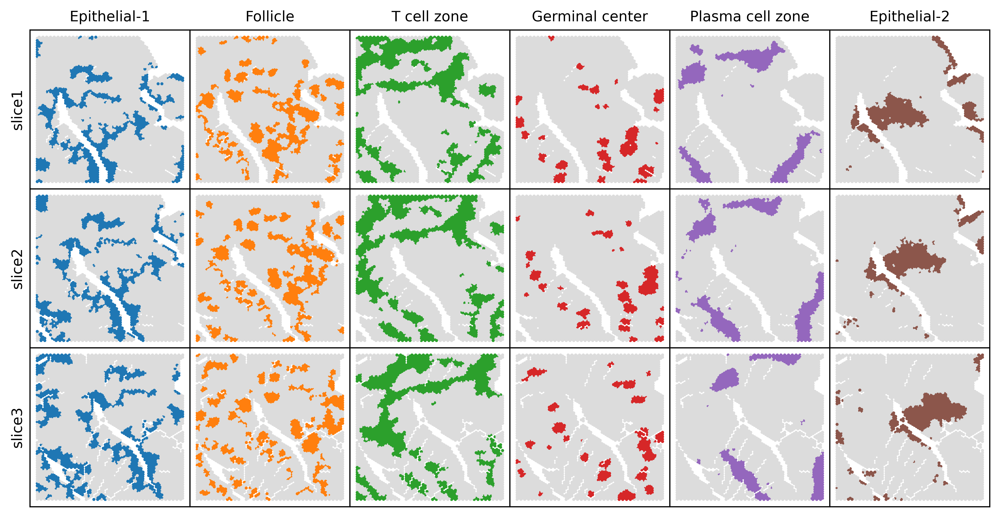

In [38]:
fig, ax_list = plt.subplots(3, 6, figsize=(12, 6),dpi=600)
plt.subplots_adjust(hspace=0, wspace=0)

for j in range(1,7):
    i=j-1
    n=list(colordict2.keys())
    sc.pl.embedding(adata[adata.obs["src"]=="s1"].copy(), basis='spatial', color='SMART-MS Clusters Anno', ax=ax_list[0][i], palette={n[k]:colordict2[n[k]] if k+1==j else "#DCDCDC" for k in range(6)},title=n[i], s=18, show=False)
    sc.pl.embedding(adata[adata.obs["src"]=="s2"].copy(), basis='spatial', color='SMART-MS Clusters Anno', ax=ax_list[1][i], palette={n[k]:colordict2[n[k]] if k+1==j else "#DCDCDC" for k in range(6)},title='', s=18, show=False)
    sc.pl.embedding(adata[adata.obs["src"]=="s3"].copy(), basis='spatial', color='SMART-MS Clusters Anno', ax=ax_list[2][i], palette={n[k]:colordict2[n[k]] if k+1==j else "#DCDCDC" for k in range(6)},title='', s=18, show=False)

    if i==0:
        ax_list[0][i].set_ylabel("slice1")
        ax_list[1][i].set_ylabel("slice2")
        ax_list[2][i].set_ylabel("slice3")
    else:
        ax_list[1][i].set_ylabel("")
        ax_list[0][i].set_ylabel("")
        ax_list[2][i].set_ylabel("")
    ax_list[0][i].set_xlabel("")
    ax_list[1][i].set_xlabel("")
    ax_list[2][i].set_xlabel("")

    
    ax_list[0][i].get_legend().remove()
    ax_list[1][i].get_legend().remove()
    ax_list[2][i].get_legend().remove()
plt.show()
fig.savefig("cluster2.jpg",format="jpg",bbox_inches='tight',transparent=True)

In [40]:
import squidpy as sq

df_morans=pd.DataFrame(columns=["method","cluster","batch","morans_i"])

sc.pp.neighbors(adata, use_rep="spatial",n_neighbors=10)
for j in ["SMART-MS","MultiVI","Present-BC","TotalVI","MOFA+"]:
    for i in range(4,9):
        for b in ["s1","s2","s3"]:
            adata_=adata_all[adata_all.obs["src"]==b]
            r=sq.gr.spatial_autocorr(adata_, connectivity_key='connectivities', genes=[f"{j}_{i}"], mode='moran',attr="obs",copy=True) 
            #alt = sc.metrics.morans_i(adata, obsm=f"X_{j}")
            df_morans.loc[len(df_morans)]=[j,i,b,r["I"][0]]

/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/numba/core/decorators.py:246: RuntimeWarning: nopython is set for njit and is ignored
  warnings.warn('nopython is set for njit and is ignored', RuntimeWarning)
/tmp/ipykernel_126232/1637334820.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df_morans.loc[len(df_morans)]=[j,i,b,r["I"][0]]
/tmp/ipykernel_126232/1637334820.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df_morans.loc[len(df_morans)]=[j,i,b,r["I"][0]]
/tmp/ipykernel_126232/1637334820.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version

/tmp/ipykernel_126232/262634556.py:31: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(["slice1","slice2","slice3"])


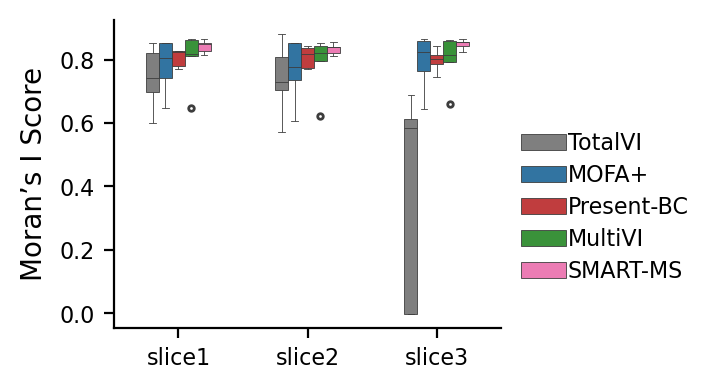

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcdefaults()
color_dicts = {
    'MOFA+': '#1f77b4',     # blue
    'MEFISTO': '#ff7f0e',   # orange
    'MultiVI': '#2ca02c',   # green
    'PRESENT': '#d62728',   # red
    'scMM': '#9467bd',      # purple
    'SpatialGlue': '#8c564b',  # brown
    'TotalVI': '#e377c2',   # pink
    'SpaMultiVAE': '#7f7f7f',  # gray
    'CellCharter': '#bcbd22',  # yellow-green
    'MISO': '#17becf',      # cyan
    'COSMOS': '#FFC0CB',    # light pink
    'SMART': '#ff69b4',     # hot pink
    'SNF': '#ff6347',       # tomato red
    'WNN': '#4682b4',       # steel blue
}


fig,ax = plt.subplots(figsize=(2.5,2),dpi=200)
ax.tick_params(labelsize=8)
sns.boxplot(data=df_morans,x="batch",y="morans_i",hue="method",linewidth=0.3,width=0.5,fliersize=2,
            ax=ax,palette=color_dicts,
            hue_order=df_morans.groupby("method")["morans_i"].median().sort_values(ascending=True).index
           )
ax.legend(bbox_to_anchor=(1,0.7),frameon=False,ncol=1,labelspacing=0.4,handletextpad=0.1,fontsize=8)
ax.set_ylabel("Moran’s I Score")
ax.set_xlabel("")
#ax.get_lengend().remove()
ax.set_xticklabels(["slice1","slice2","slice3"])
sns.despine()
fig.savefig("Moran.svg",format="svg",bbox_inches='tight',transparent=True)

/tmp/ipykernel_126232/4079091719.py:4: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 1}` instead.

  sns.barplot(data=df_ari,x="batch",y="score",hue="method",linewidth=0.3,width=0.5, edgecolor='black',
/tmp/ipykernel_126232/4079091719.py:12: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(["All","slice1","slice2","slice3"])


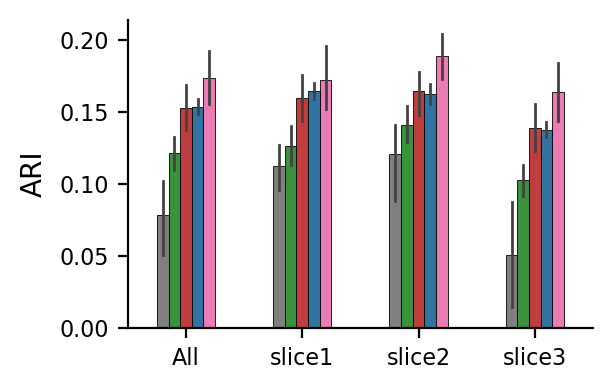

In [77]:
fig,ax = plt.subplots(figsize=(3,2),dpi=200)
ax.tick_params(labelsize=8)
df_ari=df_sup[(df_sup["metries"]=="ARI")&(df_sup["method"].isin(["SMART-MS","MultiVI","Present-BC","TotalVI","MOFA+"]))]
sns.barplot(data=df_ari,x="batch",y="score",hue="method",linewidth=0.3,width=0.5, edgecolor='black',
            ax=ax,palette=color_dicts,
            order=["all","s1","s2","s3"],errwidth=1,
            hue_order=df_ari.groupby("method")["score"].mean().sort_values(ascending=True).index
           )
#ax.legend(bbox_to_anchor=(1,0.7),frameon=False,ncol=1,labelspacing=0.1,handletextpad=0.1,fontsize=8)
ax.set_ylabel("ARI")
ax.set_xlabel("")
ax.set_xticklabels(["All","slice1","slice2","slice3"])
sns.despine()
ax.get_legend().remove()
fig.savefig("ARI.svg",format="svg",bbox_inches='tight',transparent=True)

In [44]:
from plottable import ColumnDefinition, Table
from plottable.cmap import normed_cmap
from plottable.plots import bar
import matplotlib as mpl
import numpy as np

In [70]:

num_embeds = 7
_METRIC_TYPE="Metric Type"
_AGGREGATE_SCORE = "Aggregate score"

cmap_fn = lambda col_data: normed_cmap(col_data, cmap=mpl.cm.BuGn, num_stds=1.5)

# Do not want to plot what kind of metric it is
plot_df = df1.drop(_METRIC_TYPE, axis=0)

sort_col = "Total"

plot_df = plot_df.sort_values(by=sort_col, ascending=False).astype(np.float64)
plot_df["Method"] = plot_df.index

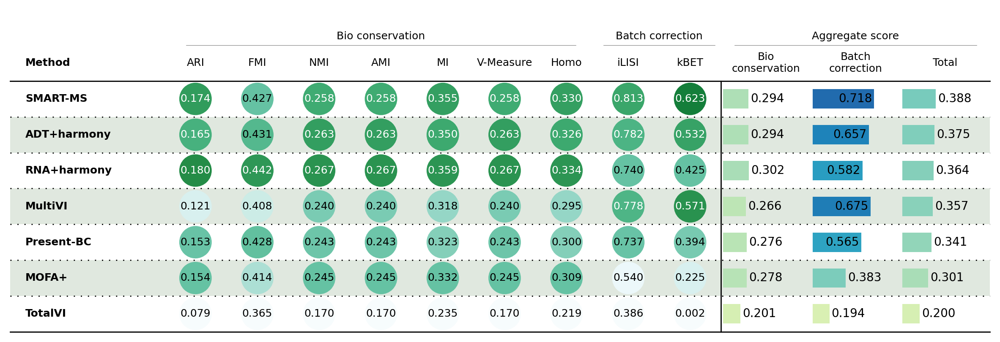

In [72]:
from plottable import ColumnDefinition, Table
from plottable.cmap import normed_cmap
from plottable.plots import bar


df=df1
# Split columns by metric type, using df as it doesn't have the new method col
score_cols = df.columns[df.loc[_METRIC_TYPE] == _AGGREGATE_SCORE]
other_cols = df.columns[df.loc[_METRIC_TYPE] != _AGGREGATE_SCORE]
column_definitions = [
    ColumnDefinition("Method", width=2.5, textprops={"ha": "left", "weight": "bold"}),
]
# Circles for the metric values
column_definitions += [
    ColumnDefinition(
        col,
        title=col.replace(" ", "\n", 1),
        width=1,
        textprops={
            "ha": "center",
            "bbox": {"boxstyle": "circle", "pad": 0.05},
        },
        cmap=cmap_fn(plot_df[col]),
        group=df.loc[_METRIC_TYPE, col],
        formatter="{:.3f}",
    )
    for i, col in enumerate(other_cols)
]
# Bars for the aggregate scores
column_definitions += [
    ColumnDefinition(
        col,
        width=1.45,
        title=col.replace(" ", "\n", 1),
        plot_fn=bar,
        plot_kw={
            "cmap": mpl.cm.YlGnBu,
            "plot_bg_bar": False,
            "annotate": True,
            "height": 0.9,
            "lw": 0.5,
            "formatter": "{:.3f}",
        },
        group=df.loc[_METRIC_TYPE, col],
        border="left" if i == 0 else None,
    )
    for i, col in enumerate(score_cols)
]
# Allow to manipulate text post-hoc (in illustrator)
with mpl.rc_context({"svg.fonttype": "none",'figure.dpi':200}):
    fig, ax = plt.subplots(figsize=(15,5))
    tab = Table(
        plot_df,
        cell_kw={
            "linewidth": 0,
            "edgecolor": "k",
        },
        column_definitions=column_definitions,
        ax=ax,
        row_dividers=True,
        footer_divider=True,
        textprops={"fontsize": 9, "ha": "center"},
        row_divider_kw={"linewidth": 1, "linestyle": (0, (1, 5))},
        col_label_divider_kw={"linewidth": 1, "linestyle": "-"},
        column_border_kw={"linewidth": 1, "linestyle": "-"},
        index_col="Method",
    ).autoset_fontcolors(colnames=plot_df.columns)
    for idx in [1, 3, 5]:
        tab.rows[idx].set_facecolor("#e0e8df")
plt.show()
fig.savefig("total_score.svg",format="svg",bbox_inches='tight',transparent=True)